Importing libraries

In [1]:
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import os
import seaborn as sns
import numpy as np
from skimage.util import montage
from skimage.segmentation import mark_boundaries
import tensorflow as tf

In [2]:
train_image_dir = r"D:\Ship detection dataset\train_v2"
train_encode_file = r"D:\Ship detection dataset\train_ship_segmentations_v2.csv"
test_image_dir = r"D:\Ship detection dataset\test_v2"

Train directory

In [3]:
train_images = os.listdir(train_image_dir)
print(f"Total {len(train_images)} images in the train directory. \nHere are the first 5 images: - {train_images[:5]}")

Total 192556 images in the train directory. 
Here are the first 5 images: - ['00003e153.jpg', '0001124c7.jpg', '000155de5.jpg', '000194a2d.jpg', '0001b1832.jpg']


Test directory

In [4]:
test_images = os.listdir(test_image_dir)
print(f"Total {len(test_images)} images in the test directory. \nHere are the first 5 images: - {test_images[:5]}")

Total 15606 images in the test directory. 
Here are the first 5 images: - ['00002bd58.jpg', '00015efb6.jpg', '00023d5fc.jpg', '000367c13.jpg', '0008ca6e9.jpg']


Visualize some test images

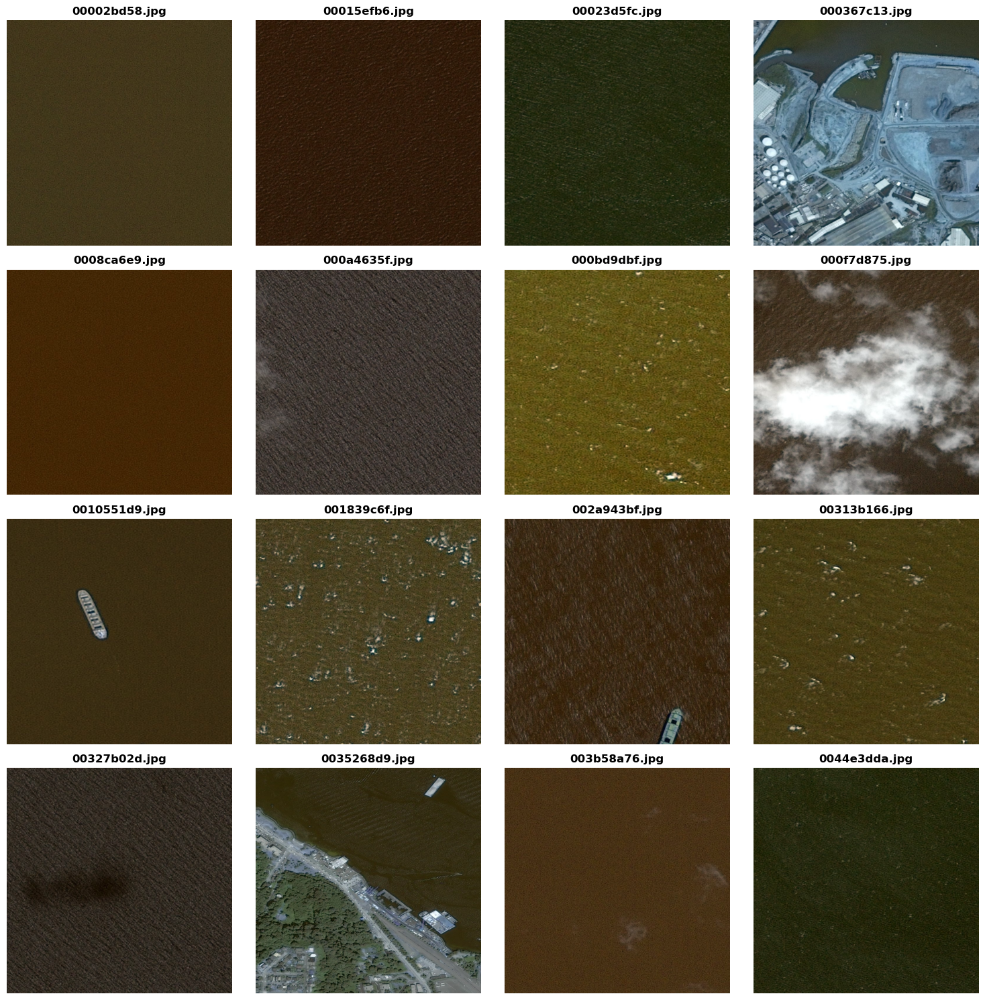

In [5]:
plt.figure(figsize=(15, 15))
for i in range(16):
    plt.subplot(4, 4, i + 1)
    plt.imshow(cv2.imread(test_image_dir + '/' + test_images[i]))
    plt.title(f"{test_images[i]}", weight='bold')
    plt.axis('off')
plt.tight_layout()

Read the CSV file

In [6]:
df = pd.read_csv(train_encode_file)

In [7]:
df.info()  # Some information about train_encode_file

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 231723 entries, 0 to 231722
Data columns (total 2 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   ImageId        231723 non-null  object
 1   EncodedPixels  81723 non-null   object
dtypes: object(2)
memory usage: 3.5+ MB


In [8]:
df.describe()

,ImageId,EncodedPixels
count,231723,81723
unique,192556,81722
top,e6fd0c12e.jpg,43801 1 44567 4 45334 5 46100 8 46867 9 47636 ...
freq,15,2


In [9]:
df.head(10)

,ImageId,EncodedPixels
0,00003e153.jpg,NaN
1,0001124c7.jpg,NaN
2,000155de5.jpg,264661 17 265429 33 266197 33 266965 33 267733...
3,000194a2d.jpg,360486 1 361252 4 362019 5 362785 8 363552 10 ...
4,000194a2d.jpg,51834 9 52602 9 53370 9 54138 9 54906 9 55674 ...
5,000194a2d.jpg,198320 10 199088 10 199856 10 200624 10 201392...
6,000194a2d.jpg,55683 1 56451 1 57219 1 57987 1 58755 1 59523 ...
7,000194a2d.jpg,254389 9 255157 17 255925 17 256693 17 257461 ...
8,0001b1832.jpg,NaN
9,00021ddc3.jpg,108287 1 109054 3 109821 4 110588 5 111356 5 1...


In [10]:
df[df["ImageId"] == "00021ddc3.jpg"]  # In df, for the same image, we have more than one ship, and each ship is in a separate row.

,ImageId,EncodedPixels
9,00021ddc3.jpg,108287 1 109054 3 109821 4 110588 5 111356 5 1...
10,00021ddc3.jpg,101361 1 102128 3 102896 4 103663 6 104430 9 1...
11,00021ddc3.jpg,74441 3 75207 5 75975 5 76743 5 77511 5 78280 ...
12,00021ddc3.jpg,74444 4 75212 4 75980 4 76748 4 77517 3 78285 ...
13,00021ddc3.jpg,150423 2 151190 3 151958 3 152726 4 153495 3 1...
14,00021ddc3.jpg,139644 2 140408 6 141174 9 141942 9 142711 6 1...
15,00021ddc3.jpg,75972 3 76738 5 77506 5 78274 5 79042 6 79811 ...
16,00021ddc3.jpg,86727 2 87493 4 88261 4 89030 3 89798 4 90566 ...
17,00021ddc3.jpg,95225 2 95992 5 96760 7 97527 9 98294 9 99062 ...


Build a dictionary where the key is the image id, and the value is the number of ships in the image

In [11]:
ship_num = {}

In [12]:
for index, row in df.iterrows():
    image_id = row['ImageId']
    encoding = row['EncodedPixels']
    if pd.isna(encoding) or encoding == "":
        ship_num[image_id] = 0
    else:
        if image_id in ship_num:
            ship_num[image_id] += 1
        else:
            ship_num[image_id] = 1

In [13]:
print(ship_num)

{'00003e153.jpg': 0, '0001124c7.jpg': 0, '000155de5.jpg': 1, '000194a2d.jpg': 5, '0001b1832.jpg': 0, '00021ddc3.jpg': 9, '0002756f7.jpg': 2, '0002d0f32.jpg': 0, '000303d4d.jpg': 0, '00031f145.jpg': 1, '00052ed46.jpg': 0, '000532683.jpg': 2, '00053c6ba.jpg': 1, '00057a50d.jpg': 0, '000592296.jpg': 0, '0005d01c8.jpg': 2, '0005d6d95.jpg': 1, '0006c52e8.jpg': 1, '0007b8229.jpg': 0, '000805313.jpg': 0, '000811bb6.jpg': 0, '0008d6216.jpg': 0, '000913daf.jpg': 0, '000952d51.jpg': 0, '000969125.jpg': 0, '0009a46e1.jpg': 0, '000a4d4fd.jpg': 0, '000aed819.jpg': 0, '000baef0c.jpg': 0, '000bd9ac4.jpg': 0, '000c150b0.jpg': 0, '000c34352.jpg': 0, '000d26c17.jpg': 0, '000d42241.jpg': 1, '000db3e62.jpg': 0, '000e37fc6.jpg': 0, '000e6378b.jpg': 1, '000e64855.jpg': 0, '000f1f959.jpg': 0, '000f7e728.jpg': 0, '000f7f2fd.jpg': 0, '000fd9827.jpg': 1, '00104f16f.jpg': 0, '0010e88ce.jpg': 0, '0010eefb1.jpg': 0, '00113a75c.jpg': 7, '00119e4ba.jpg': 0, '0011a9ccb.jpg': 0, '0011c31b7.jpg': 0, '00122061c.jpg': 0,

Number of ships in this image is: 1


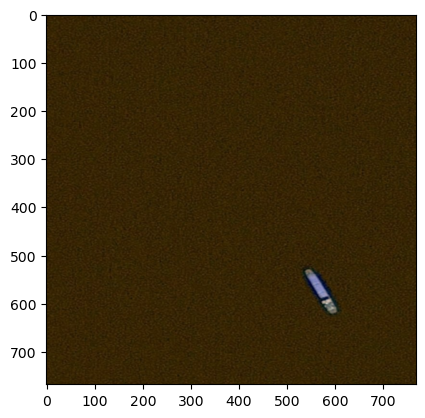

In [14]:
img = cv2.imread(train_image_dir + "/30d3f7721.jpg")
plt.imshow(img)
print(f"Number of ships in this image is: {ship_num['30d3f7721.jpg']}")  # Verify the number of ships for the image with id 30d3f7721.jpg

In [15]:
print(len(ship_num))
# Coincides with the unique number of elements
# Number of images

192556


Transform the dictionary into a DataFrame for easier information manipulation

In [16]:
MonData = pd.DataFrame(list(ship_num.items()), columns=['ImageId', 'ships'])

In [17]:
MonData.head(10)

,ImageId,ships
0,00003e153.jpg,0
1,0001124c7.jpg,0
2,000155de5.jpg,1
3,000194a2d.jpg,5
4,0001b1832.jpg,0
5,00021ddc3.jpg,9
6,0002756f7.jpg,2
7,0002d0f32.jpg,0
8,000303d4d.jpg,0
9,00031f145.jpg,1


We verified that the image with id 00003e153.jpg does not have any ships

This image with id "00003e153.jpg" does not represent any ship according to the previous table.


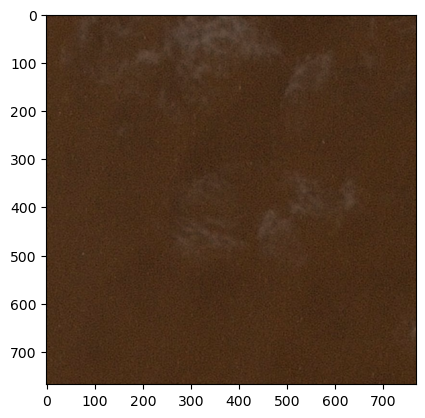

In [18]:
img = cv2.imread(train_image_dir + "/00003e153.jpg")
plt.imshow(img)
print("This image with id \"00003e153.jpg\" does not represent any ship according to the previous table.")

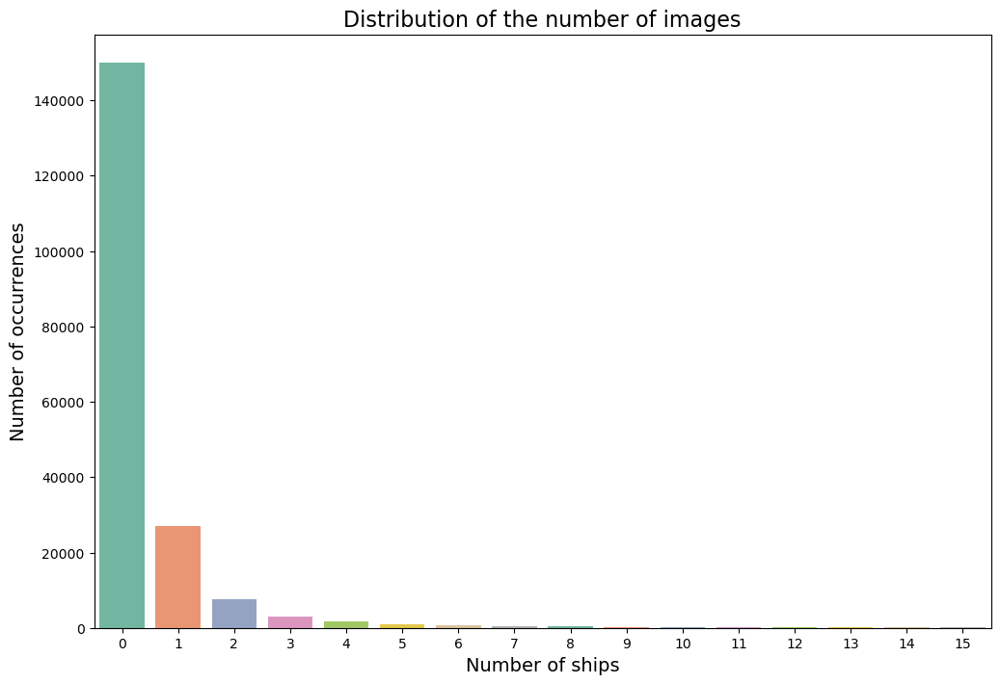

In [19]:
plt.figure(figsize=(12, 8))  # Adjust the figure size
sns.countplot(data=MonData, x='ships', palette='Set2')
# Add labels and a title
plt.title('Distribution of the number of images', fontsize=16)
plt.xlabel('Number of ships', fontsize=14)
plt.ylabel('Number of occurrences', fontsize=14)
plt.show()

In [20]:
MonData['ships'].value_counts()  # Number of images with the same number of ships
# We can observe an imbalance in the distribution of images based on the number of ships.

ships
0     150000
1      27104
2       7674
3       2954
4       1622
5        925
6        657
7        406
8        318
9        243
10       168
11       144
12       124
14        76
13        75
15        66
Name: count, dtype: int64

List of image paths

In [21]:
image_paths = [
    os.path.join(train_image_dir, filename) for filename in os.listdir(train_image_dir)
]

In [22]:
image_paths[10:20]

['D:\\Ship detection dataset\\train_v2\\00052ed46.jpg',
 'D:\\Ship detection dataset\\train_v2\\000532683.jpg',
 'D:\\Ship detection dataset\\train_v2\\00053c6ba.jpg',
 'D:\\Ship detection dataset\\train_v2\\00057a50d.jpg',
 'D:\\Ship detection dataset\\train_v2\\000592296.jpg',
 'D:\\Ship detection dataset\\train_v2\\0005d01c8.jpg',
 'D:\\Ship detection dataset\\train_v2\\0005d6d95.jpg',
 'D:\\Ship detection dataset\\train_v2\\0006c52e8.jpg',
 'D:\\Ship detection dataset\\train_v2\\0007b8229.jpg',
 'D:\\Ship detection dataset\\train_v2\\000805313.jpg']

In [23]:
print(df.isnull().sum())  # Check for missing values

ImageId               0
EncodedPixels    150000
dtype: int64


Detailed analysis of images

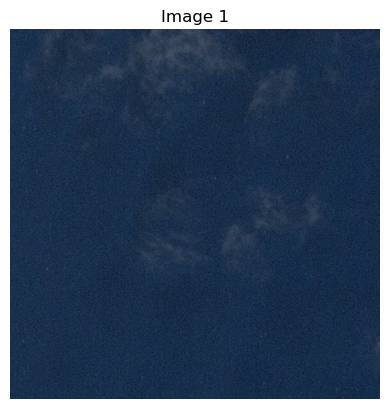

Image dimensions: 768 x 768 pixels
Number of channels: 3
Image size: 589824 pixels


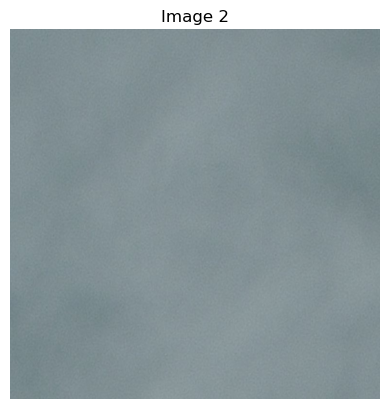

Image dimensions: 768 x 768 pixels
Number of channels: 3
Image size: 589824 pixels


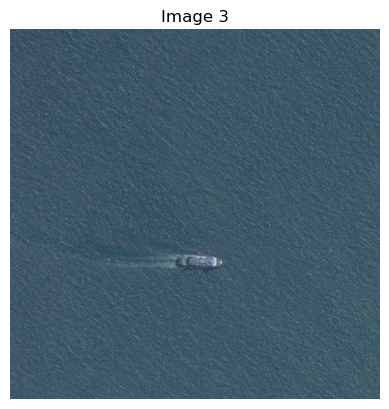

Image dimensions: 768 x 768 pixels
Number of channels: 3
Image size: 589824 pixels


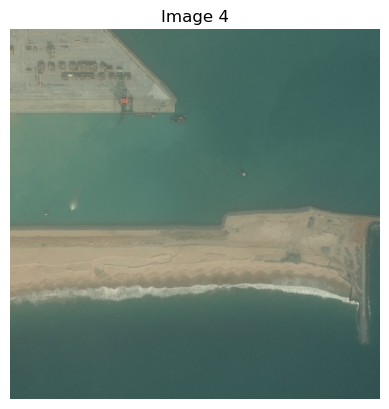

Image dimensions: 768 x 768 pixels
Number of channels: 3
Image size: 589824 pixels


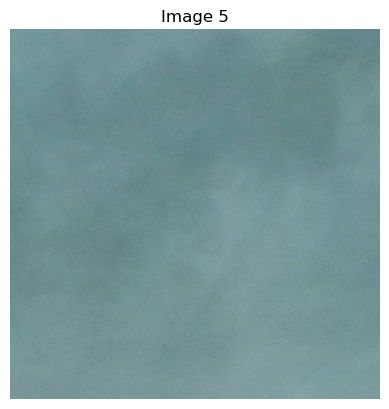

Image dimensions: 768 x 768 pixels
Number of channels: 3
Image size: 589824 pixels


In [24]:
for i in range(5):
    image = cv2.imread(image_paths[i])
    height, width, channels = image.shape  # Get the dimensions of the image
    image_size = height * width  # Calculate the size of the image
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(f"Image {i + 1}")
    plt.axis('off')
    plt.show()
    print(f"Image dimensions: {height} x {width} pixels")
    print(f"Number of channels: {channels}")
    print(f"Image size: {image_size} pixels")

In [25]:
print('Number of images in CSV:', len(df))
print('Number of images in the image file:', len(image_paths))

Number of images in CSV: 231723
Number of images in the image file: 192556


In [26]:
number_images_without_ship = 0
number_images_with_ship = 0

Iterate through the ship_num dictionary

In [27]:
for number_ships in ship_num.values():
    if number_ships == 0:
        number_images_without_ship += 1
    else:
        number_images_with_ship += 1

Create two lists for the x and y axes of the graph

Number of images without ship 150000
Number of images with ship 42556


<BarContainer object of 2 artists>

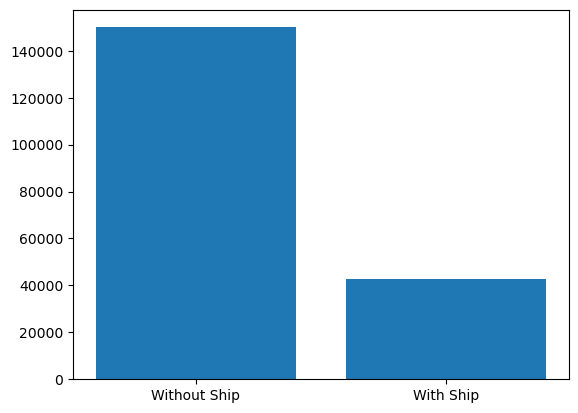

In [28]:
categories = ['Without Ship', 'With Ship']
number_images = [number_images_without_ship, number_images_with_ship]
print("Number of images without ship", number_images_without_ship)
print("Number of images with ship", number_images_with_ship)
# Create a bar chart
plt.bar(categories, number_images)

Label the axes of the graph

Text(0, 0.5, 'Number of images')

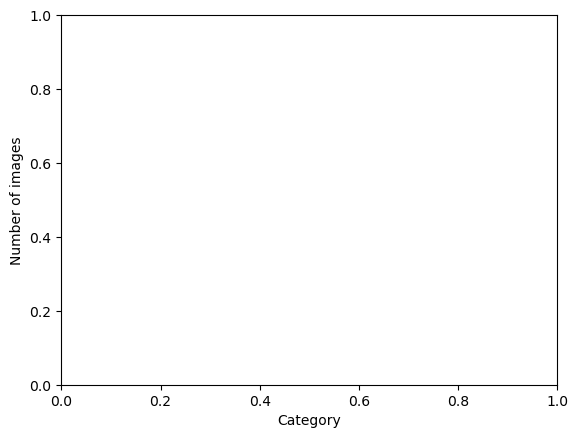

In [29]:
plt.xlabel('Category')
plt.ylabel('Number of images')

Display the graph

In [30]:
plt.show()

Create a new column 'Size' that contains the number of pixels per ship

In [31]:
df['Size'] = df['EncodedPixels'].apply(lambda x: 0 if pd.isna(x) else sum(map(int, str(x).split()[1::2])))

Group the data by size and count the number of ships of each size

In [32]:
ship_sizes = df[df['Size'] > 0]['Size'].value_counts().reset_index()
ship_sizes.columns = ['Ship Size (in pixels)', 'Number of Ships']

Sort the data by size in ascending order

In [33]:
ship_sizes = ship_sizes.sort_values(by='Ship Size (in pixels)')

Plot the graph

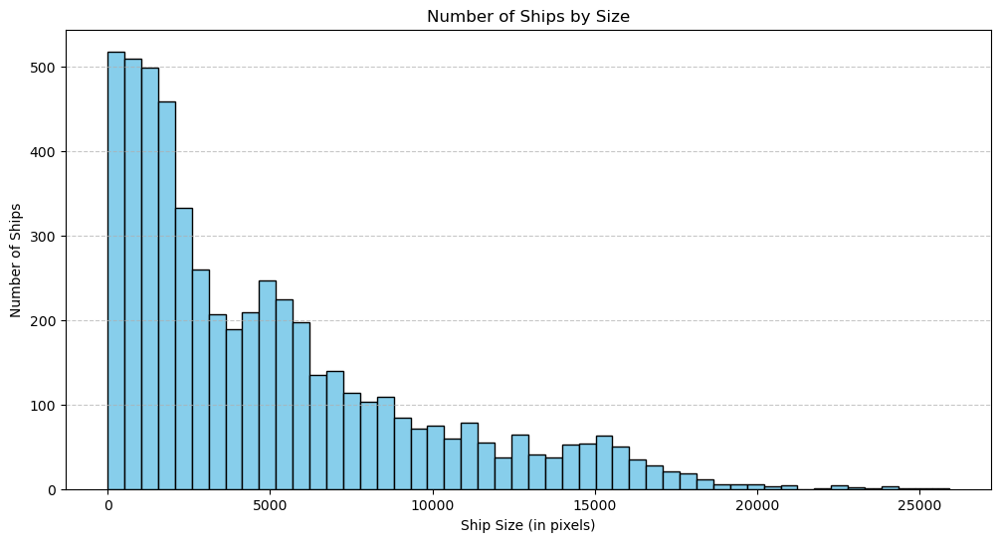

In [34]:
plt.figure(figsize=(12, 6))
plt.hist(ship_sizes['Ship Size (in pixels)'], bins=50, color='skyblue', edgecolor='black')
#plt.bar(ship_sizes['Ship Size (in pixels)'], ship_sizes['Number of Ships'])
plt.title('Number of Ships by Size')
plt.xlabel('Ship Size (in pixels)')
plt.ylabel('Number of Ships')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

In [35]:
df['file_size_kb'] = df['ImageId'].map(
    lambda c_img_id: os.stat(os.path.join(train_image_dir, c_img_id)).st_size / 1024)  # calculate file sizes

In [36]:
df.head()

,ImageId,EncodedPixels,Size,file_size_kb
0,00003e153.jpg,NaN,0,128.944336
1,0001124c7.jpg,NaN,0,76.059570
2,000155de5.jpg,264661 17 265429 33 266197 33 266965 33 267733...,3388,147.625977
3,000194a2d.jpg,360486 1 361252 4 362019 5 362785 8 363552 10 ...,177,75.221680
4,000194a2d.jpg,51834 9 52602 9 53370 9 54138 9 54906 9 55674 ...,148,75.221680


In [37]:
def plot_color_histogram(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert the image from BGR to RGB (Matplotlib uses the RGB format)
    plt.imshow(image_rgb)
    plt.title('Original Image')
    plt.axis('off')
    plt.show()
    r, g, b = cv2.split(image_rgb)  # Split the image into its color channels (Red, Green, Blue)
    plt.figure(figsize=(12, 4))
    # Histogram for the red channel
    plt.subplot(131)
    plt.hist(r.flatten(), bins=256, color='red', alpha=0.7, rwidth=0.8)
    plt.title('Red Histogram')
    plt.xlabel('Pixel Value')
    plt.ylabel('Frequency')

    # Histogram for the green channel
    plt.subplot(132)
    plt.hist(g.flatten(), bins=256, color='green', alpha=0.7, rwidth=0.8)
    plt.title('Green Histogram')
    plt.xlabel('Pixel Value')
    plt.ylabel('Frequency')

    # Histogram for the blue channel
    plt.subplot(133)
    plt.hist(b.flatten(), bins=256, color='blue', alpha=0.7, rwidth=0.8)
    plt.title('Blue Histogram')
    plt.xlabel('Pixel Value')
    plt.ylabel('Frequency')
    plt.tight_layout()
    plt.show()

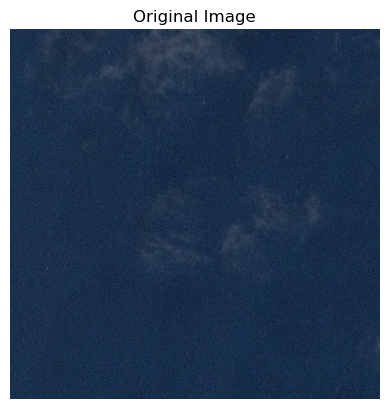

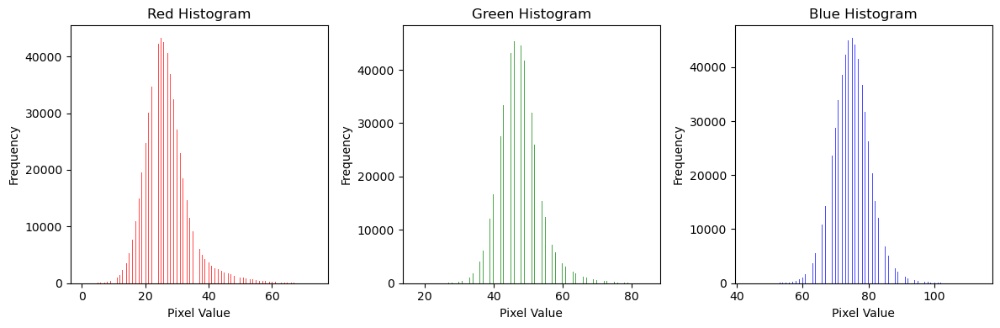

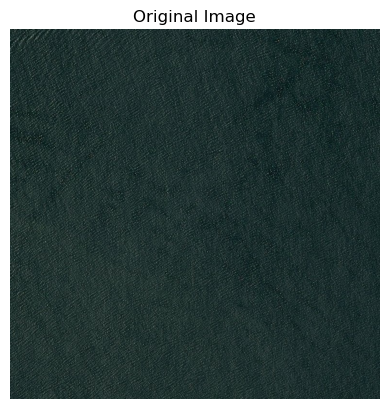

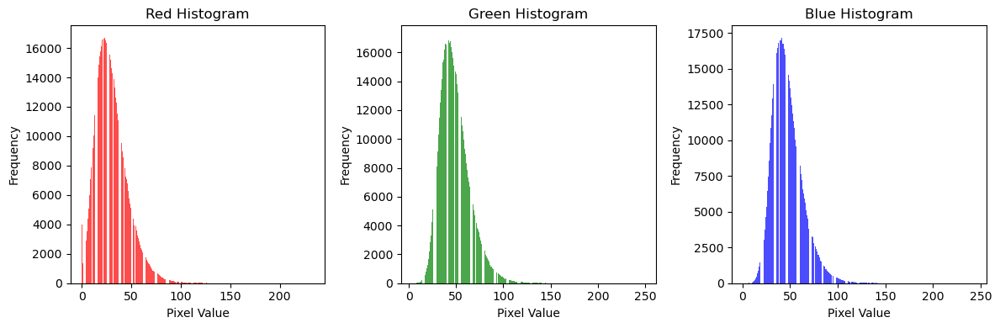

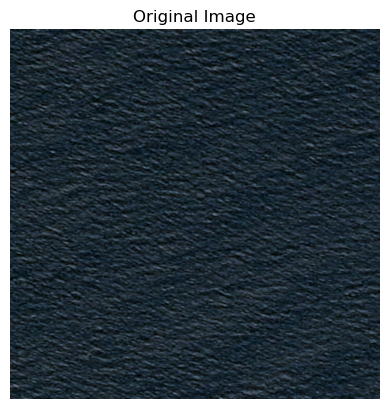

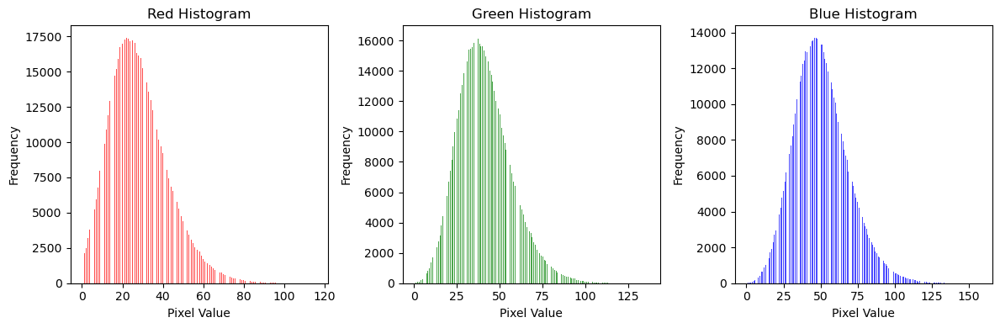

In [38]:
image_paths[0:]
plot_color_histogram(image_paths[0])
plot_color_histogram(image_paths[10])
plot_color_histogram(image_paths[900])

In [39]:
def orientation_distribution(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Load the image in grayscale
    # Apply the Sobel filter to get the gradients
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=5)
    gradient_orientation = np.arctan2(sobely, sobelx)  # Calculate the orientation of the gradients
    gradient_orientation_degrees = np.degrees(gradient_orientation)  # Convert the orientation to degrees
    flattened_orientation = gradient_orientation_degrees.flatten()  # Flatten the array for the histogram
    # Show the original image
    plt.subplot(121)
    plt.imshow(image, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')
    # Show the histogram of orientations
    plt.subplot(122)
    plt.hist(flattened_orientation, bins=36, range=[-180, 180], color='black', alpha=0.7)
    plt.title('Orientation Histogram')
    plt.xlabel('Orientation in degrees')
    plt.ylabel('Frequency')
    plt.tight_layout()  # Automatically adjust spaces to avoid overlap
    plt.show()

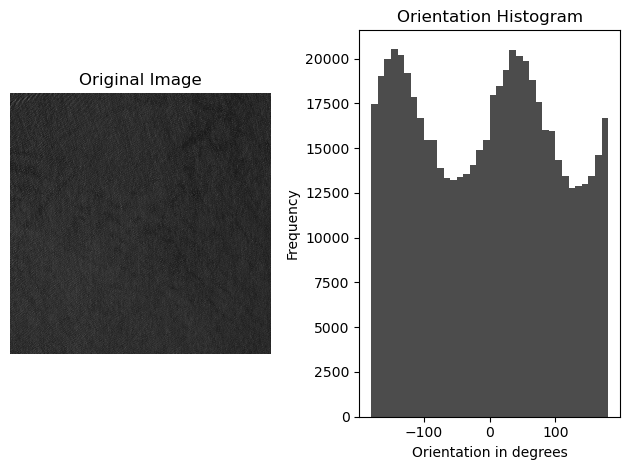

In [40]:
orientation_distribution(image_paths[10])


<br>
**The maximum frequency of the diagram is 17500, corresponding to an orientation of 100 degrees. This suggests that the dominant orientation of objects in the image is 100 degrees, which corresponds to the orientation of the ship.**<br>


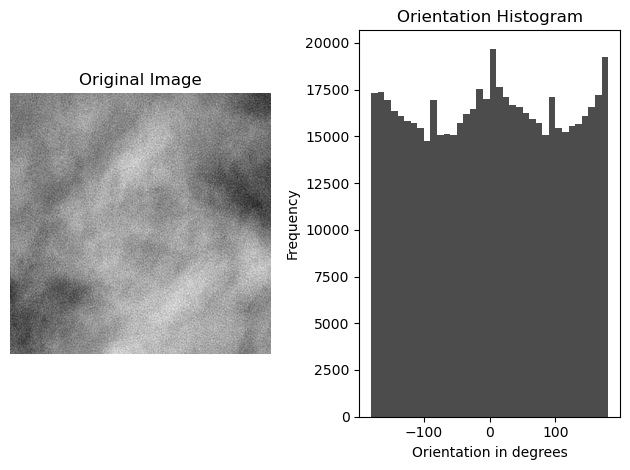

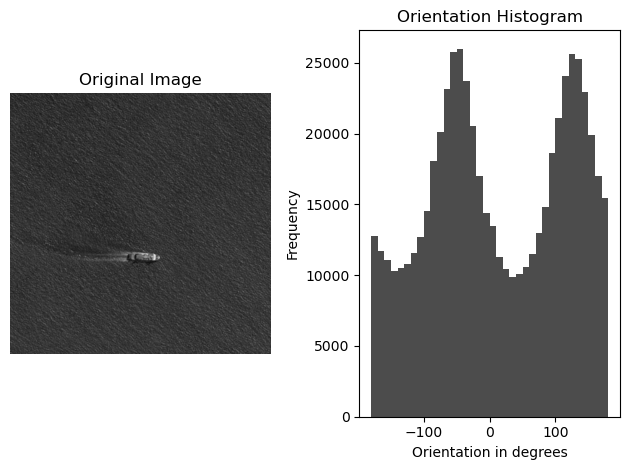

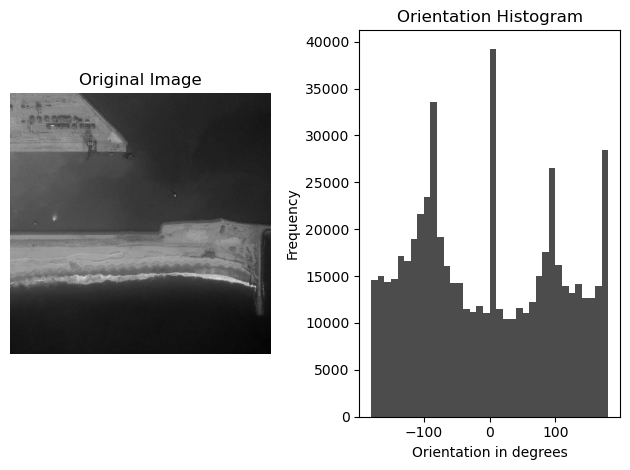

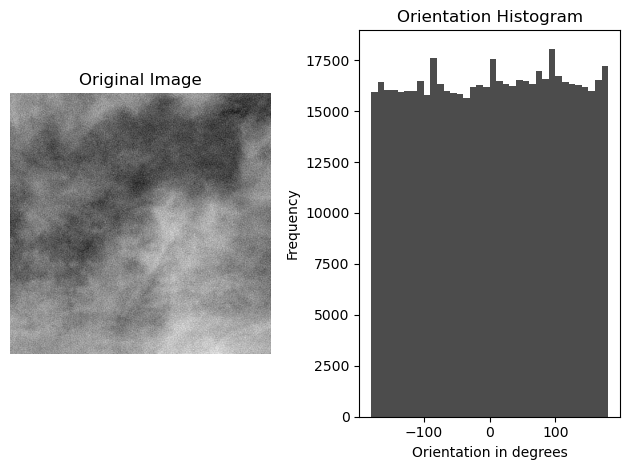

In [41]:
for i in range(1, 5):
    orientation_distribution(image_paths[i])

In [42]:
def detect_keypoints(image_path):
    image = cv2.imread(image_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    orb = cv2.ORB_create()  # Initialize the ORB extractor
    keypoints, descriptors = orb.detectAndCompute(gray_image, None)  # Detect keypoints and descriptors with ORB
    image_with_keypoints = cv2.drawKeypoints(image, keypoints, None)  # Draw keypoints on the image
    # Display the image with keypoints
    plt.imshow(cv2.cvtColor(image_with_keypoints, cv2.COLOR_BGR2RGB))
    plt.title('Keypoint Detection with ORB (Oriented FAST and Rotated BRIEF)')
    plt.axis('off')
    plt.show()

Call the detect_keypoints function for a specific image path

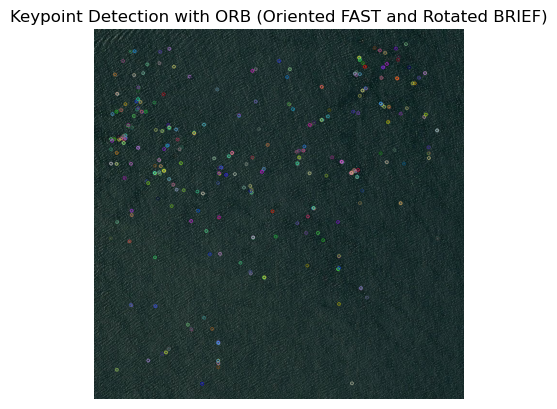

In [43]:
detect_keypoints(image_paths[10])


<br>
We notice that most of the keypoints obtained by the ORB filter are on the ship.<br>



<br>
Evaluate sharpness and contrast of an image.<br>


In [44]:
def evaluate_sharpness_contrast(image_path):
    image = cv2.imread(image_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    laplacian = cv2.Laplacian(gray_image, cv2.CV_64F)  # Calculate the Laplacian filter to evaluate sharpness
    sharpness = np.var(laplacian)  # Calculate the variance of the Laplacian image for sharpness
    contrast = np.max(gray_image) - np.min(gray_image)  # Calculate the contrast of the image
    # Normalize values between 0 and 1
    sharpness_normalized = sharpness / (sharpness + contrast)
    contrast_normalized = contrast / (sharpness + contrast)
    # Produce a normalized overall score
    score_normalized = (sharpness_normalized + contrast_normalized) / 2
    return score_normalized


<br>
There are 192,225 examples; analyzing all images would be too time-consuming. Focus on a sample of 4000 images to maintain efficiency.<br>


In [45]:
contrast = set()  # Initialize a set
for i in range(4000):
    pt = image_paths[i]
    score = evaluate_sharpness_contrast(pt)
    contrast.add(score)

Display the contrast scores

In [46]:
contrast

{0.4999999999999999, 0.49999999999999994, 0.5, 0.5000000000000001}


<br>
We notice that all images have the same contrast and sharpness score.<br>


In [47]:
shape_unique = set()
for i in range(4000):
    pt = image_paths[i]
    image = cv2.imread(image_paths[i])
    shape_unique.add(image.shape)

Display the unique shapes of images

In [48]:
shape_unique

{(768, 768, 3)}


<br>
Exploratory Data Analysis (EDA) provided an initial understanding of image features. Now, we will focus on specific data preprocessing techniques, including segmentation by a binary mask, to extract finer information on regions of interest. This is crucial as segmentation allows for more precise ship detection, especially in a uniform distribution of water, considering that ship positions are given in the CSV file. We will also explore model selection and hyperparameter optimization, which will be a U-Net for the moment, and don't forget about data augmentation.<br>


Data Preprocessing

In [49]:
def rle_decode(mask_rle, shape=(768, 768)):
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape).T

In [50]:
def masks_image(in_mask_list):
    # Display an example of a training image and its mask
    all_masks = np.zeros((768, 768), dtype = np.uint8)
    for mask in in_mask_list:
        if isinstance(mask, str):
            all_masks |= rle_decode(mask)
    return all_masks

Additional data preprocessing steps

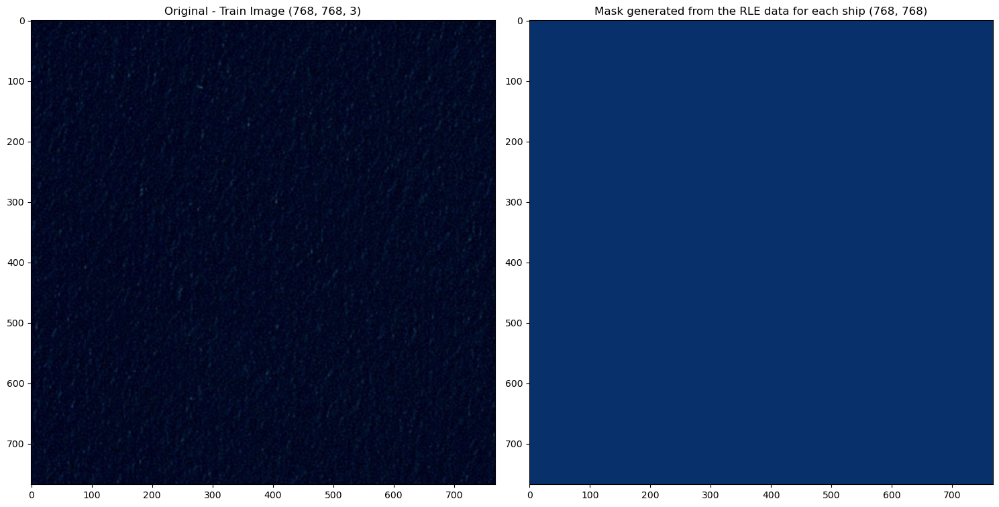

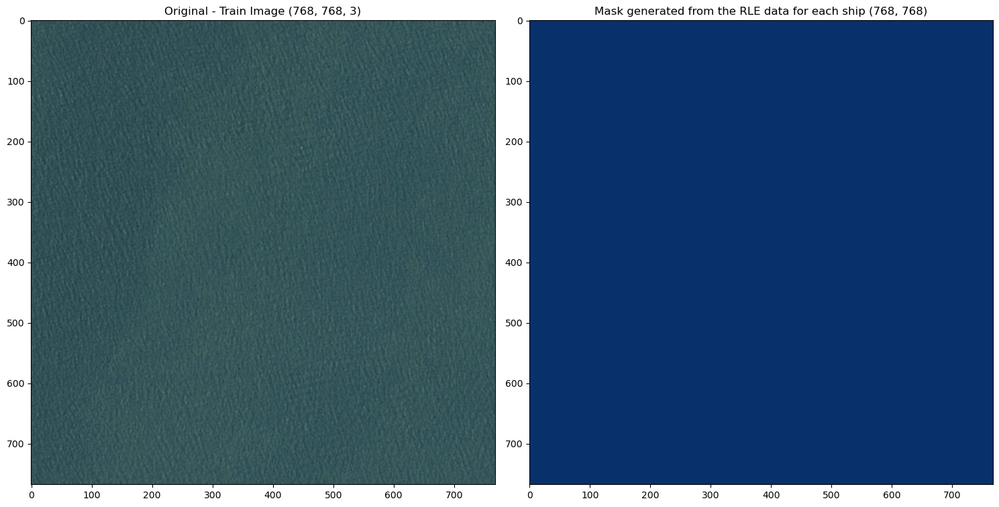

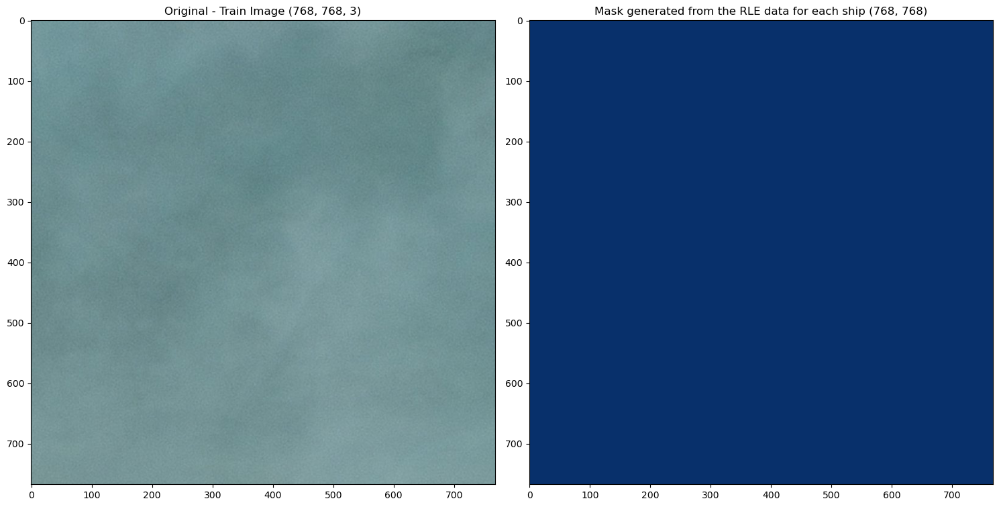

In [51]:
from skimage.io import imread
for num in [100, 88, 5]:
    rle_0 = df.query(f'ImageId=="{train_images[num-1]}"')['EncodedPixels']
    img_0 = masks_image(rle_0)
    original = imread(train_image_dir+"/"+train_images[num-1])
    plt.figure(figsize=(15, 8))
    plt.subplot(1, 2, 1)
    plt.title(f"Original - Train Image {original.shape}")
    plt.imshow(original)
    plt.subplot(1, 2, 2)
    plt.title(f"Mask generated from the RLE data for each ship {img_0.shape}")
    plt.imshow(img_0, cmap = "Blues_r")
    plt.tight_layout()
    plt.show()

<Axes: >

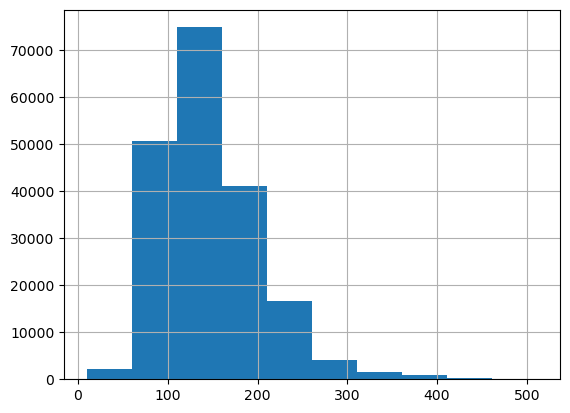

In [52]:
MonData['file_size_kb']=MonData['ImageId'].map(lambda c_img_id:os.stat(os.path.join(train_image_dir,c_img_id)).st_size/1024) # file size calculation
MonData['file_size_kb'].hist()

Filter the data to include only entries with a file size greater than 50 KB

(191289, 3)

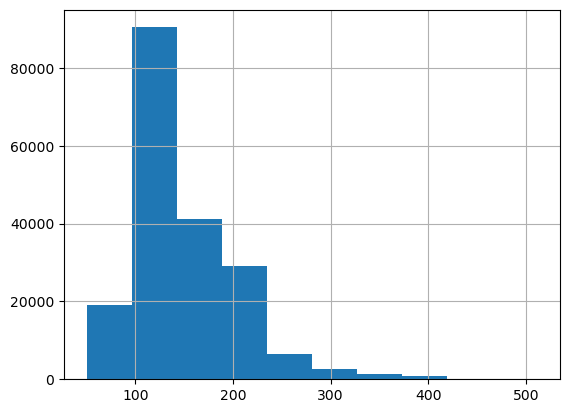

In [53]:
MonData = MonData[MonData.file_size_kb > 50]  
# Plot a histogram of the 'file_size_kb' column to visualize the distribution of file sizes
MonData['file_size_kb'].hist()
# Select randomly 7 samples from the dataset
MonData.sample(7)  
# Display the shape of the dataset
MonData.shape

Drop the 'Size' column from the DataFrame 'df'

In [54]:
df.drop(['Size'], axis=1, inplace=True)

In [55]:
MonData.head()

,ImageId,ships,file_size_kb
0,00003e153.jpg,0,128.944336
1,0001124c7.jpg,0,76.059570
2,000155de5.jpg,1,147.625977
3,000194a2d.jpg,5,75.221680
4,0001b1832.jpg,0,95.627930


In [56]:
from sklearn.model_selection import train_test_split

Split the 'MonData' dataset into training (train) and validation (valid) sets

In [57]:
train, valid = train_test_split(MonData, test_size=0.2, stratify=MonData['ships'])
print("The shape of the training dataframe is:", train.shape)

The shape of the training dataframe is: (153031, 3)


Merge the 'df' DataFrame with the 'train' DataFrame

In [58]:
train_df = pd.merge(df, train)
train_df.sort_values(by='ImageId')  # Sort the resulting DataFrame 'train_df' by the 'ImageId' column
# Display the 'train_df' DataFrame
print(train_df)

              ImageId                                      EncodedPixels  \
0       00003e153.jpg                                                NaN   
1       000155de5.jpg  264661 17 265429 33 266197 33 266965 33 267733...   
2       000194a2d.jpg  360486 1 361252 4 362019 5 362785 8 363552 10 ...   
3       000194a2d.jpg  51834 9 52602 9 53370 9 54138 9 54906 9 55674 ...   
4       000194a2d.jpg  198320 10 199088 10 199856 10 200624 10 201392...   
...               ...                                                ...   
184066  fffe4fa23.jpg                                                NaN   
184067  fffedbb6b.jpg                                                NaN   
184068  ffff2aa57.jpg                                                NaN   
184069  ffffc50b4.jpg                                                NaN   
184070  ffffe97f3.jpg                                                NaN   

        file_size_kb  ships  
0         128.944336      0  
1         147.625977      1


The number of rows in 'train' was 153031 after splitting into train and validation, <br>
but after merging, the size of the train dataframe is 184071 rows. <br>
This represents lines from the same image but with different ships, <br>
 the lines in 'df' represent ships and an image can contain multiple ships.


Merge with the 'df' DataFrame to create the 'valid_df' DataFrame for validation

In [59]:
valid_df = pd.merge(df, valid)
print("The shape of the validation dataframe is:", valid_df.shape)

The shape of the validation dataframe is: (46011, 4)


In [60]:
print("We find:")
print(train_df.shape[0], 'training masks,')
print(valid_df.shape[0], 'validation masks.')

We find:
184071 training masks,
46011 validation masks.


Plot the ship count distribution in the training data

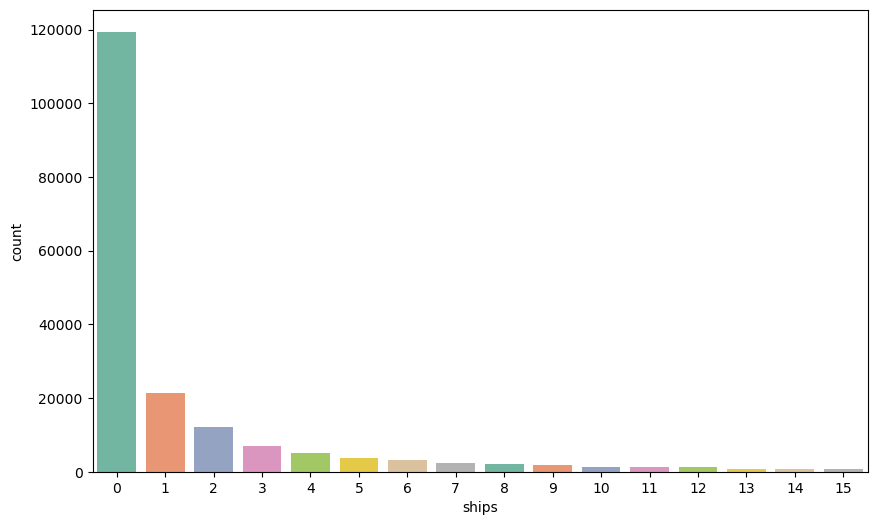

In [61]:
plt.figure(figsize=(10, 6))
sns.countplot(data=train_df, x='ships', palette='Set2')
plt.show()

The goal of this code is to try to merge the number of ships per image into two classes <br>
to balance the different images

In [62]:
train_df['grouped_ship_count'] = train_df.ships.map(lambda x: (x+1)//2).clip(0, 7)
train_df.head()

,ImageId,EncodedPixels,file_size_kb,ships,grouped_ship_count
0,00003e153.jpg,NaN,128.944336,0,0
1,000155de5.jpg,264661 17 265429 33 266197 33 266965 33 267733...,147.625977,1,1
2,000194a2d.jpg,360486 1 361252 4 362019 5 362785 8 363552 10 ...,75.221680,5,3
3,000194a2d.jpg,51834 9 52602 9 53370 9 54138 9 54906 9 55674 ...,75.221680,5,3
4,000194a2d.jpg,198320 10 199088 10 199856 10 200624 10 201392...,75.221680,5,3


0 is the image with no ships<br>
1 represents images with one ship and images with two ships

In [63]:
train_df.grouped_ship_count.value_counts()  # Display the count of unique values in the 'grouped_ship_count' column of 'train_df'

grouped_ship_count
0    119434
1     33490
2     12122
3      6802
4      4276
5      3077
6      2441
7      2429
Name: count, dtype: int64

Function to sample entries based on the number of ships

In [64]:
def sample_ships(in_df, base_rep_val=2100):
    if in_df['ships'].values[0] == 0:  # Check if the number of ships is equal to 0
        return in_df.sample(base_rep_val // 3)   # Sample one-third of the value 2100
    else:
        return in_df.sample(base_rep_val)

Create a more or less balanced DataFrame

In [65]:
balanced_train_df = train_df.groupby('grouped_ship_count').apply(sample_ships)
balanced_train_df.grouped_ship_count.value_counts()
print("The shape of the balanced dataframe is:", balanced_train_df.shape)

The shape of the balanced dataframe is: (15400, 5)


For each subgroup from 0 to 7, display the number of training images grouped by the number of ships

In [66]:
for i in range(8):
    df_val_counts = balanced_train_df[balanced_train_df.grouped_ship_count==i].ships.value_counts()
    print(f"Data frame for grouped ship count = {i}:-\n{df_val_counts}\nSum of Values:- {df_val_counts.values.sum()}\n\n")

Data frame for grouped ship count = 0:-
ships
0    700
Name: count, dtype: int64
Sum of Values:- 700


Data frame for grouped ship count = 1:-
ships
1    1321
2     779
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 2:-
ships
3    1247
4     853
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 3:-
ships
5    1120
6     980
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 4:-
ships
7    1120
8     980
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 5:-
ships
9     1200
10     900
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 6:-
ships
11    1072
12    1028
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 7:-
ships
14    746
15    680
13    674
Name: count, dtype: int64
Sum of Values:- 2100




Visualize the distribution of training data before and after balancing

In [67]:
plt.figure(figsize=(15, 5))
plt.suptitle("Train Data", fontsize=18, color='r', weight='bold')

Text(0.5, 0.98, 'Train Data')

<Figure size 1500x500 with 0 Axes>

Text(0.5, 0, '# Ships in an image')

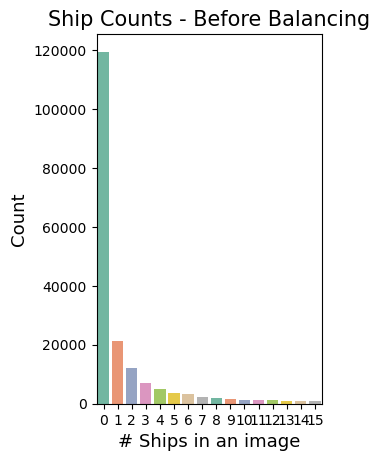

In [68]:
plt.subplot(1, 2, 1)
sns.countplot(data=train_df, x='ships', palette='Set2')
plt.title("Ship Counts - Before Balancing", fontsize=15)
plt.ylabel("Count", fontsize=13)
plt.xlabel("# Ships in an image", fontsize=13)

Text(0, 0.5, 'Count')

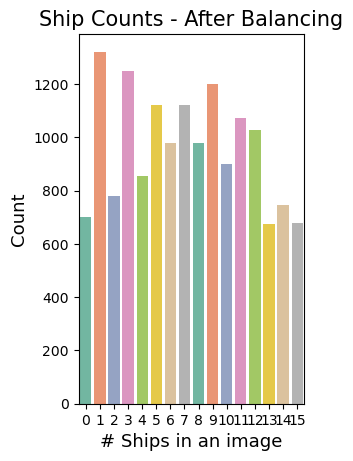

In [69]:
plt.subplot(1, 2, 2)
sns.countplot(data=balanced_train_df, x='ships', palette='Set2')
plt.title("Ship Counts - After Balancing", fontsize=15)
plt.xlabel("# Ships in an image", fontsize=13)
plt.ylabel("Count", fontsize=13)

In [70]:
plt.tight_layout()
plt.show()

<Figure size 640x480 with 0 Axes>

In [71]:
BATCH_SIZE = 48  # Batch size
IMG_SCALING = (3, 3)  # Image resizing parameter

In [72]:
def make_image_gen(in_df, batch_size=BATCH_SIZE):
    all_batches = list(in_df.groupby('ImageId'))
    out_rgb = []
    out_mask = []
    while True:
        np.random.shuffle(all_batches)  # Shuffle the order of batches
        for c_img_id, c_masks in all_batches:
            # Path to the RGB image
            rgb_path = os.path.join(train_image_dir, c_img_id)
            c_img = imread(rgb_path)  # Load the image
            c_mask = np.expand_dims(masks_image(c_masks['EncodedPixels'].values), -1)  # Create the mask from pixel encodings
            # Resize the image and mask if specified
            if IMG_SCALING is not None:
                c_img = c_img[::IMG_SCALING[0], ::IMG_SCALING[1]]
                c_mask = c_mask[::IMG_SCALING[0], ::IMG_SCALING[1]]

            # Add the image and mask to the lists
            out_rgb += [c_img]
            out_mask += [c_mask]
            # If the batch size is reached, yield the batch
            if len(out_rgb) >= batch_size:
                yield np.stack(out_rgb, 0) / 255.0, np.stack(out_mask, 0)
                out_rgb, out_mask = [], []  # Reset the lists for the next batch

Call the function to generate training images

In [73]:
train_gen = make_image_gen(balanced_train_df)
# Image and Mask
train_x, train_y = next(train_gen)
print(f"train_x ~\nShape: {train_x.shape}\nMin value: {train_x.min()}\nMax value: {train_x.max()}")
print(f"\ntrain_y ~\nShape: {train_y.shape}\nMin value: {train_y.min()}\nMax value: {train_y.max()}")

train_x ~
Shape: (48, 256, 256, 3)
Min value: 0.0
Max value: 1.0

train_y ~
Shape: (48, 256, 256, 1)
Min value: 0
Max value: 1


Visualize a batch of training data

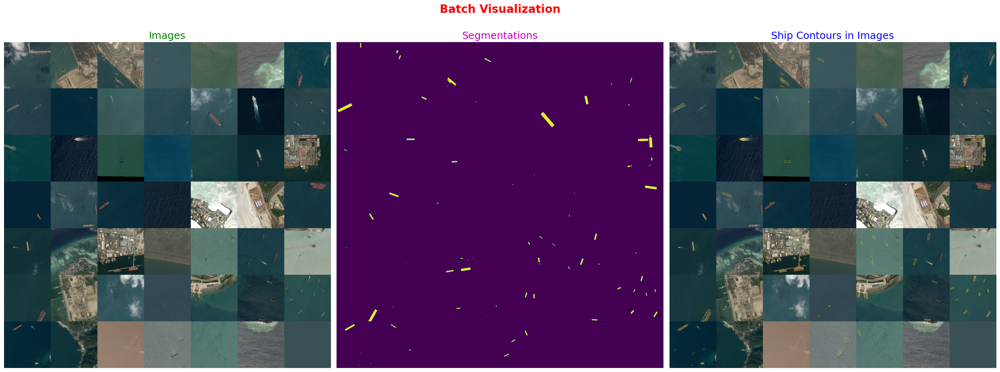

In [74]:
from skimage.segmentation import mark_boundaries
montage_rgb = lambda x: np.stack([montage(x[:, :, :, i]) for i in range(x.shape[3])], -1)
batch_rgb = montage_rgb(train_x) 
batch_seg = montage(train_y[:, :, :, 0])  
batch_overlap = mark_boundaries(batch_rgb, batch_seg.astype(int)) 
titles = ["Images", "Segmentations", "Ship Contours in Images"]
colors = ['g', 'm', 'b']
display = [batch_rgb, batch_seg, batch_overlap]
plt.figure(figsize=(25, 10))
for i in range(3):
    plt.subplot(1, 3, i+1) 
    plt.imshow(display[i])
    plt.title(titles[i], fontsize=18, color=colors[i])
    plt.axis('off')
plt.suptitle("Batch Visualization", fontsize=20, color='r', weight='bold')
plt.tight_layout()

In [75]:
VALID_IMG_COUNT = 400 # Set the number of validation images
valid_x, valid_y = next(make_image_gen(valid_df, VALID_IMG_COUNT))
print(f"valid_x ~\nShape: {valid_x.shape}\nvalue min: {valid_x.min()}\nvalue max: {valid_x.max()}")
print(f"\nvalid_y ~\nShape: {valid_y.shape}\n value min: {valid_y.min()}\nvalue max: {valid_y.max()}")

valid_x ~
Shape: (400, 256, 256, 3)
value min: 0.0
value max: 1.0

valid_y ~
Shape: (400, 256, 256, 1)
 value min: 0
value max: 1


Using ImageDataGenerator for data augmentation

In [76]:
from keras.preprocessing.image import ImageDataGenerator

Parameters for image augmentation

In [77]:
dg_args = dict(rotation_range=15,          # Range of degrees for random rotations
               horizontal_flip=True,       # Perform random horizontal flips
               vertical_flip=True,         # Perform random vertical flips
               data_format='channels_last')  # channels_last refers to (batch, height, width, channels)

In [78]:
image_gen = ImageDataGenerator(**dg_args)  # Create an image generator with the specified parameters
label_gen = ImageDataGenerator(**dg_args)  # Create a label generator with the specified parameters

Define a function to create an augmented generator

In [79]:
def create_aug_gen(in_gen, seed=None):
    np.random.seed(seed if seed is not None else np.random.choice(range(9999)))
    for in_x, in_y in in_gen:
        seed = np.random.choice(range(9999))  # Set a seed to have the same augmentation for both image and mask
        g_x = image_gen.flow(255 * in_x,
                             batch_size=in_x.shape[0],
                             seed=seed,
                             shuffle=False)
        g_y = label_gen.flow(in_y,
                             batch_size=in_x.shape[0],
                             seed=seed,
                             shuffle=False)
        yield next(g_x) / 255.0, next(g_y)  # Normalize the pixel values of the image and label

Augment the training data

In [80]:
cur_gen = create_aug_gen(train_gen, seed=42)
t_x, t_y = next(cur_gen)

Display information about the augmented data

In [81]:
print('x', t_x.shape, t_x.dtype, t_x.min(), t_x.max())
print('y', t_y.shape, t_y.dtype, t_y.min(), t_y.max())

x (48, 256, 256, 3) float32 0.0 1.0
y (48, 256, 256, 1) float32 0.0 1.0


In [82]:
import random

Total number of examples

In [83]:
total_examples = t_x.shape[0]

Set a seed to make the random selection reproducible

In [84]:
random_seed = 3
random.seed(random_seed)

Randomly select indices for examples to display

In [85]:
random_indices = random.sample(range(total_examples), 4)

Display randomly selected examples of images and their masks

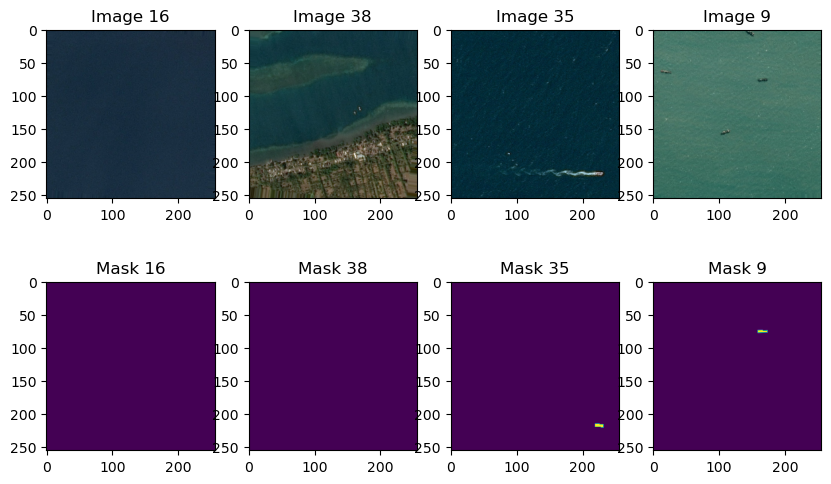

In [86]:
fig, axes = plt.subplots(2, 4, figsize=(10, 6))
for i, random_index in enumerate(random_indices):
    # Display the image
    axes[0, i].imshow(t_x[random_index])
    axes[0, i].set_title(f"Image {random_index + 1}")

    # Display the mask
    axes[1, i].imshow(t_y[random_index])
    axes[1, i].set_title(f"Mask {random_index + 1}")

In [87]:
plt.show()

Define a lambda function to create an RGB montage from an array of images

In [88]:
montage_rgb = lambda x: np.stack([montage(x[:, :, :, i]) for i in range(x.shape[3])], -1)

Final display before passing the data to the model

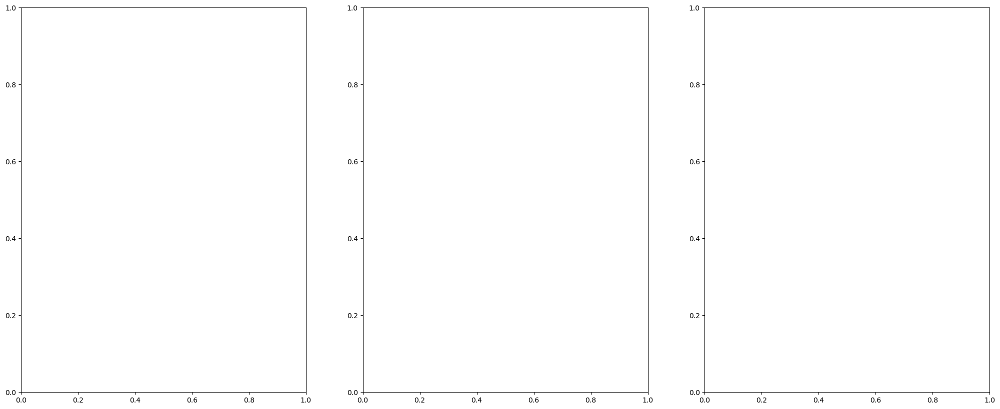

In [89]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(25, 10))

Display the RGB montage of training images

In [90]:
ax1.imshow(montage_rgb(t_x), cmap='gray')
ax1.set_title('Images', fontsize=18, color='g')
ax1.axis('off')

(-0.5, 1791.5, 1791.5, -0.5)

Display the montage of masks

In [91]:
ax2.imshow(montage(t_y[:, :, :, 0]), cmap='Blues_r')
ax2.set_title('Masks', fontsize=18, color='r')
ax2.axis('off')

(-0.5, 1791.5, 1791.5, -0.5)

Display contours around ships in training images

In [92]:
ax3.imshow(mark_boundaries(montage_rgb(t_x), montage(t_y[:, :, :, 0].astype(int))))
ax3.set_title('Bounding Box', fontsize=18, color='b')
ax3.axis('off')

(-0.5, 1791.5, 1791.5, -0.5)

In [93]:
plt.tight_layout()

<Figure size 640x480 with 0 Axes>

Model Construction

In [94]:
from keras import models, layers

In [95]:
def unet(input_size=(256, 256, 3)):
    inputs = layers.Input(input_size)
    c1 = layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(inputs)
    c1 = layers.Dropout(0.1)(c1)
    c1 = layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
    p1 = layers.MaxPooling2D((2, 2))(c1)
    c2 = layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
    c2 = layers.Dropout(0.1)(c2)
    c2 = layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
    p2 = layers.MaxPooling2D((2, 2))(c2)
    c3 = layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
    c3 = layers.Dropout(0.1)(c3)
    c3 = layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
    p3 = layers.MaxPooling2D((2, 2))(c3)
    c4 = layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
    c4 = layers.Dropout(0.1)(c4)
    c4 = layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)
    p4 = layers.MaxPooling2D((2, 2))(c4)
    c5 = layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
    c5 = layers.Dropout(0.1)(c5)
    c5 = layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)
    u6 = layers.Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c5)
    u6 = layers.concatenate([u6, c4])
    c6 = layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u6)
    c6 = layers.Dropout(0.2)(c6)
    c6 = layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c6)
    u7 = layers.Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = layers.concatenate([u7, c3])
    c7 = layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u7)
    c7 = layers.Dropout(0.2)(c7)
    c7 = layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c7)
    u8 = layers.Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = layers.concatenate([u8, c2])
    c8 = layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u8)
    c8 = layers.Dropout(0.2)(c8)
    c8 = layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)
    u9 = layers.Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = layers.concatenate([u9, c1])
    c9 = layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u9)
    c9 = layers.Dropout(0.2)(c9)
    c9 = layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)
    out = layers.Conv2D(1, (1, 1), activation='sigmoid')(c9)
    model = models.Model(inputs=[inputs], outputs=[out])
    model.summary()
    return model

In [96]:
new_model = unet()



Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 16)         448       ['input_1[0][0]']             
                                                                                                  
 dropout (Dropout)           (None, 256, 256, 16)         0         ['conv2d[0][0]']              
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 16)         2320      ['dropout[0][0]']             
                                                                                            

Model layers

In [97]:
new_model.layers

In [98]:
import keras.backend as k
import tensorflow as tf

In [99]:
def dice_coeff(y_pred, y_true):
    y_true = k.cast(y_true, dtype=tf.float32)
    y_pred = k.cast(y_pred, dtype=tf.float32)
    intersection = k.sum(y_pred * y_true, axis=[1, 2, 3])
    union = k.sum(y_pred, axis=[1, 2, 3]) + k.sum(y_true, axis=[1, 2, 3])
    dice_coefficient = k.mean((2. * intersection + 1) / (union + 1))
    return dice_coefficient

In [100]:
def focal_loss(y_pred, y_true, gamma=2, alpha=0.8):
    y_true = k.cast(y_true, dtype=tf.float32)
    y_pred = k.cast(y_pred, dtype=tf.float32)
    y_pred = k.flatten(y_pred)
    y_true = k.flatten(y_true)
    BCE = k.binary_crossentropy(y_pred, y_true)
    EXP_BCE = k.exp(-BCE)
    focal_loss = k.mean(alpha * k.pow((1 - EXP_BCE), gamma) * BCE)
    return focal_loss

Testing the function that calculates dice_coeff

In [101]:
dice_coeff_result = dice_coeff(train_x, train_y)
print(dice_coeff_result.numpy())

0.0154318055


In [102]:
from tensorflow.keras.optimizers import Adam

In [103]:
new_model.compile(optimizer=Adam(1e-3, beta_1=1e-6), loss=focal_loss, metrics=[dice_coeff])

In [104]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau

In [105]:
reduce = ReduceLROnPlateau(monitor='val_dice_coeff', factor=0.23,
                           patience=3, verbose=1, mode='max',
                           min_delta=0.0001, cooldown=2, min_lr=1e-6)

In [106]:
early = EarlyStopping(monitor="val_dice_coeff", mode="max", patience=20)

In [107]:
callbacks_list = [reduce, early]

In [108]:
aug_gen = create_aug_gen(train_gen)

In [109]:
new_model.fit(aug_gen, epochs=200, validation_data=(valid_x, valid_y), steps_per_epoch=30,
                  callbacks=callbacks_list)

Epoch 1/200


30/30 [==============================] - 353s 11s/step - loss: 0.0177 - dice_coeff: 0.0057 - val_loss: 0.0040 - val_dice_coeff: 0.0022 - lr: 0.0010
Epoch 2/200
30/30 [==============================] - 290s 9s/step - loss: 0.0061 - dice_coeff: 0.0127 - val_loss: 0.0020 - val_dice_coeff: 0.0052 - lr: 0.0010
Epoch 3/200
30/30 [==============================] - 319s 11s/step - loss: 0.0057 - dice_coeff: 0.0183 - val_loss: 0.0049 - val_dice_coeff: 0.0079 - lr: 0.0010
Epoch 4/200
30/30 [==============================] - 266s 9s/step - loss: 0.0052 - dice_coeff: 0.0239 - val_loss: 0.0029 - val_dice_coeff: 0.0091 - lr: 0.0010
Epoch 5/200
30/30 [==============================] - 265s 9s/step - loss: 0.0043 - dice_coeff: 0.0366 - val_loss: 0.0028 - val_dice_coeff: 0.0079 - lr: 0.0010
Epoch 6/200
30/30 [==============================] - 257s 9s/step - loss: 0.0044 - dice_coeff: 0.0353 - val_loss: 0.0015 - val_dice_coeff: 0.0119 - lr: 0.0010
Epoch 7/200
30/30 [=======================

In [110]:
new_model.save('new_model.h5')

c:\Users\monis\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [111]:
from tensorflow.keras.models import load_model
final_model = load_model('new_model.h5', custom_objects={'focal_loss': focal_loss, 'dice_coeff': dice_coeff})

In [112]:
def prediction(path, img_id, model):
    img = imread(os.path.join(path, img_id))
    img = img[::3, ::3]
    img = img / 255.0  # Resize the image to the size expected by the model
    img = np.expand_dims(img, axis=0)

    # Make sure to provide data to the predict method
    pred = model.predict(img)
    img = np.squeeze(img, axis=0)
    pred_squeezed = np.squeeze(pred, axis=0)
    return img, pred_squeezed

Model evaluation

(768, 768, 3)
1/1 [==============================] - 0s 59ms/step


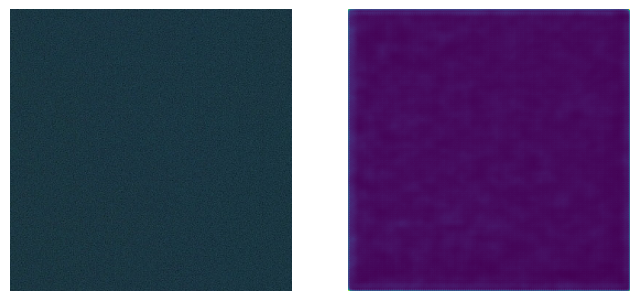

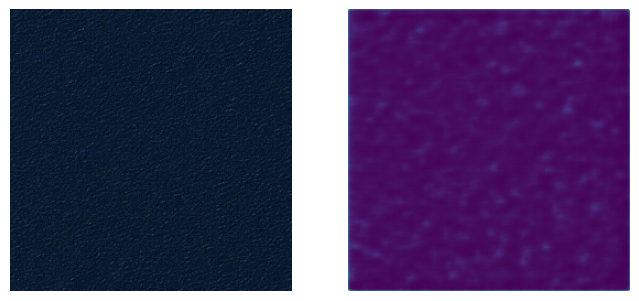

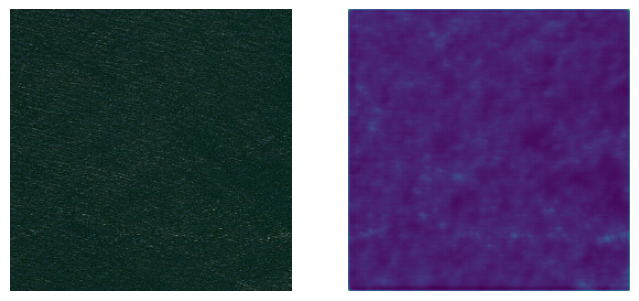

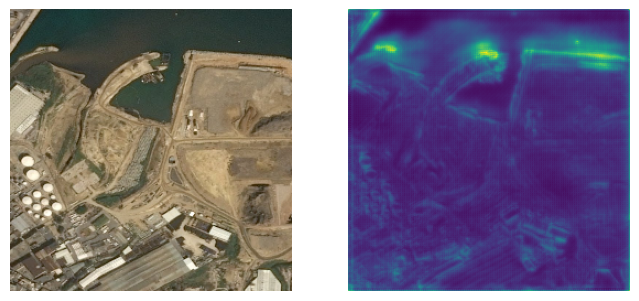

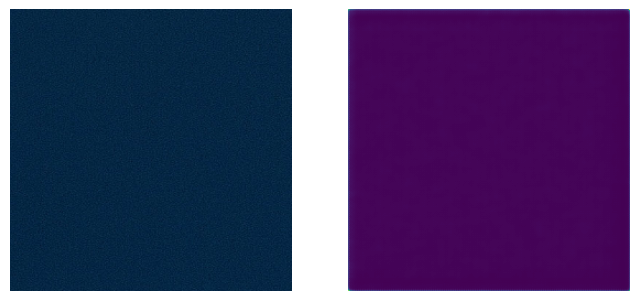

...

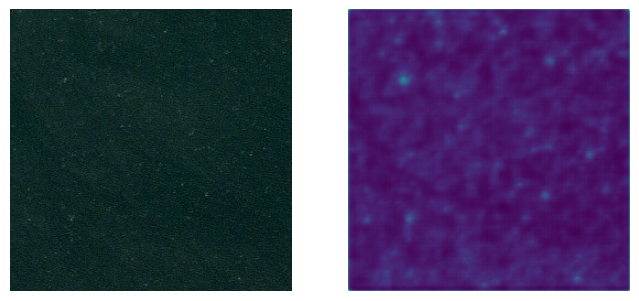

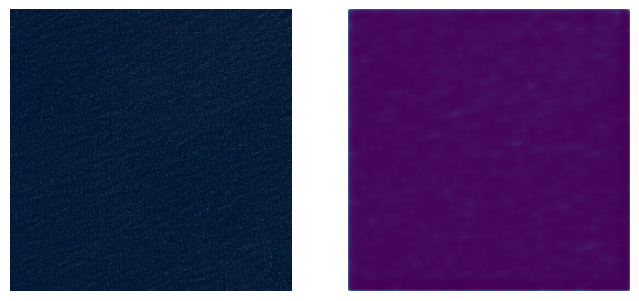

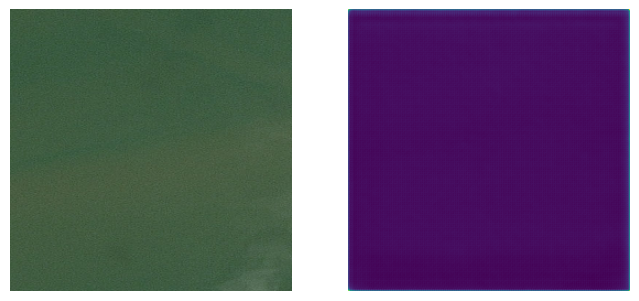

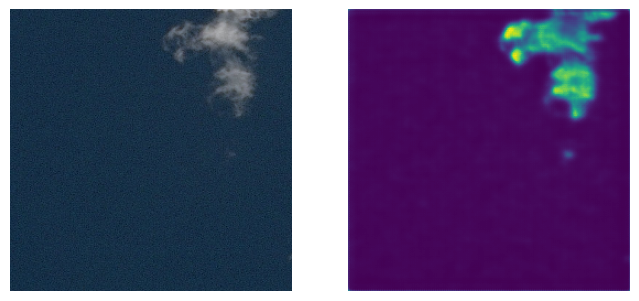

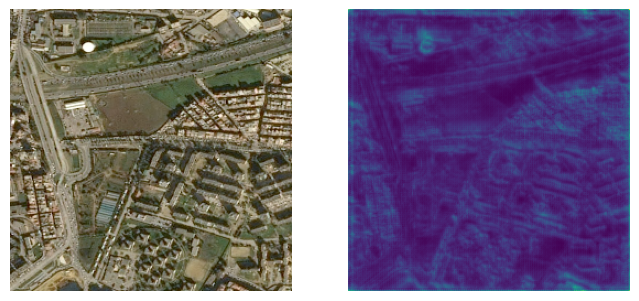

In [113]:
print(cv2.imread(r"D:\Ship detection dataset\test_v2\00002bd58.jpg").shape)
for sample in range(20):
    img, pred = prediction(r"D:\Ship detection dataset\test_v2", test_images[sample], final_model)
    fig = plt.figure(figsize=(8, 8))
    fig.add_subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis('off')
    fig.add_subplot(1, 2, 2)
    plt.imshow(pred)
    plt.axis('off')